# Examine projected flux changes by zonal integrated flux

In [1]:
# Import Modules
import pandas as pd
import xarray as xr
import numpy as np
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42
import matplotlib.pyplot as plt
%matplotlib inline
import cmocean as cm
import datetime

In [2]:
# For nice spatial maps
%run _Val_Mapping.ipynb

In [4]:
# For custom subplotting:
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [6]:
# Scenarios and Models and Directories

root_dir = "/data/artemis/simulations/CMIP6"
ssp126_dir = f"{root_dir}/SSP126"
ssp119_dir = f"{root_dir}/SSP119"
ssp245_dir = f"{root_dir}/SSP245"
ssp534_dir = f"{root_dir}/SSP534"
ssp585_dir = f"{root_dir}/SSP585"  # Same as SSP5-34 until 2040

scenarios = ['ssp126','ssp119','ssp245','ssp534','ssp585']
scen_disp = ['SSP1-26','SSP1-19','SSP2-45','SSP5-34','SSP5-85']
scen_fold = ['SSP126','SSP119','SSP245','SSP534','SSP585']
scen_colors = ['cyan','blue','green','orange','red'] # hottest most red here

# 3 Ensemble Members or More:
models = np.array([['ACCESS-ESM1-5','CNRM-ESM2-1','IPSL-CM6A-LR','MIROC-ES2L','MPI-ESM1-2-LR','UKESM1-0-LL'], #ssp1-26
                      ['CanESM5','CNRM-ESM2-1','IPSL-CM6A-LR','MIROC-ES2L','UKESM1-0-LL'], #ssp1-19
                      ['ACCESS-ESM1-5','CNRM-ESM2-1','IPSL-CM6A-LR','MPI-ESM1-2-LR','UKESM1-0-LL'], #ssp2-45
                      ['CNRM-ESM2-1','IPSL-CM6A-LR','UKESM1-0-LL'], #5-34  no 'CanESM5' because don't have it prior to 2040
                     ['ACCESS-ESM1-5','CNRM-ESM2-1','IPSL-CM6A-LR','MPI-ESM1-2-LR','UKESM1-0-LL']],dtype=object)

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in less


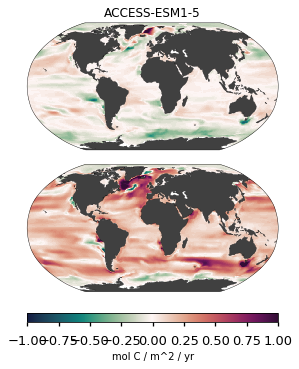

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in less


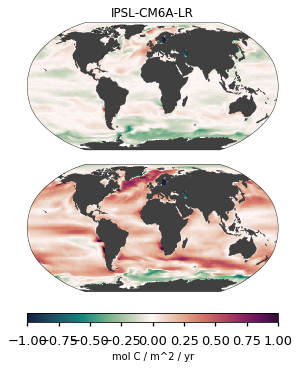

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in less


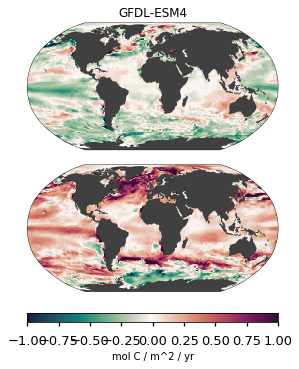

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in less


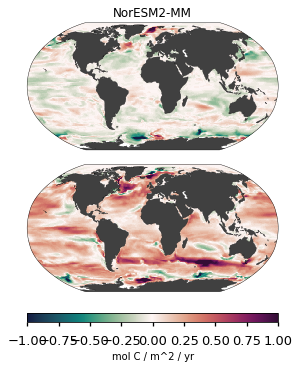

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in less


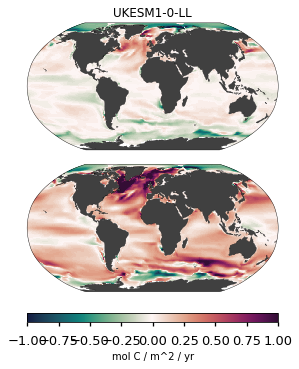

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in less


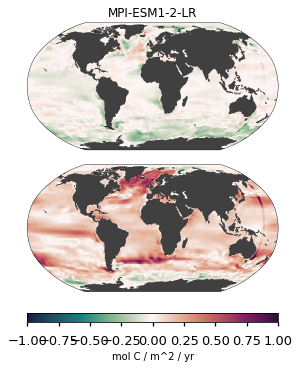

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in less


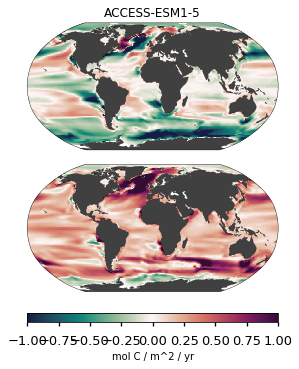

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in less


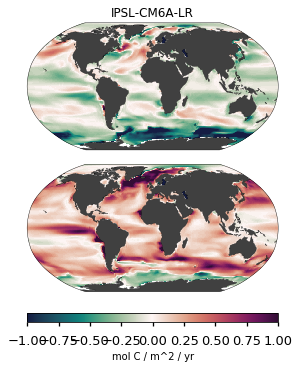

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in less


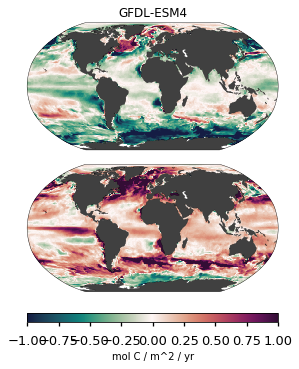

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in less


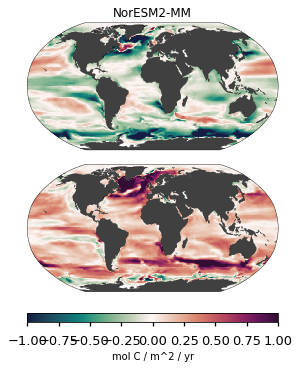

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in less


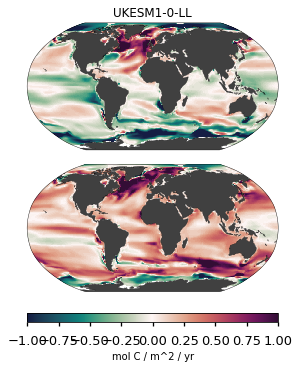

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: invalid value encountered in less


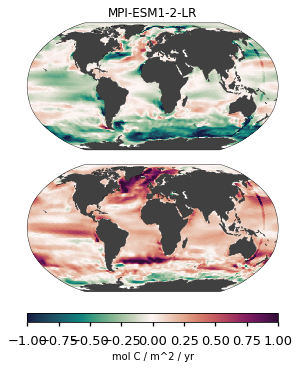

In [11]:
# SSP 1-26 and 2-45

# We plot all models (peak - initial) and (decline - peak) CO2 fluxes
# We then grab the models that contrast for publication (show all in supplementary)

# 3 Ensemble Members or More: (Get rid of CNRM from all)
models = np.array([['ACCESS-ESM1-5','IPSL-CM6A-LR','MIROC-ES2L','MPI-ESM1-2-LR','UKESM1-0-LL'], #ssp1-26
                      ['CanESM5','IPSL-CM6A-LR','MIROC-ES2L','UKESM1-0-LL'], #ssp1-19
                      ['ACCESS-ESM1-5','IPSL-CM6A-LR','MPI-ESM1-2-LR','UKESM1-0-LL'], #ssp2-45
                      ['IPSL-CM6A-LR','UKESM1-0-LL'], #5-34  no 'CanESM5' because don't have it prior to 2040
                     ['ACCESS-ESM1-5','IPSL-CM6A-LR','MPI-ESM1-2-LR','UKESM1-0-LL']],dtype=object)

s = [0,2]  # Scenario 2 is SSP2-45
levs = [-1,1]

sp1 = [2025,2050]
sp2 = [2034,2059]
sd1 = [2050,2090]
sd2 = [2059,2099]


region='world'
cmap = cm.cm.curl
plot_style = 'seaborn-talk'
vrange = [-1,1,5]

sy=0
for scen in ["ssp126","ssp245"]:
    for mod in ["ACCESS-ESM1-5","IPSL-CM6A-LR","GFDL-ESM4","NorESM2-MM","UKESM1-0-LL","MPI-ESM1-2-LR"]:
        
        
        fig = plt.figure(figsize=(4.5,7.25))
        fig_shape=(2,1)
        with plt.style.context(plot_style):
            dia = SpatialMap2(nrows_ncols=fig_shape, fig=fig, cbar_location='bottom', cbar_orientation='horizontal') 

        # Spatial Plots:
        # Load the scenario, model flux
        ds = xr.load_dataset(f"{root_dir}/{scen_fold[s[sy]]}/processed/fgco2_Omon_{mod}_{scen}_mean_1x1_201501-210012.nc")
        ds = ds.rename({"T":"time"})
        fx = ds.fgco2.groupby("time.year").mean("time") # get annual means
        
        # Difference between "peak" years and mean of 2015-2025:
        data1 = (-1*fx.sel(year=slice(sp1[sy],sp2[sy])).mean("year")+fx.sel(year=slice(2015,2025)).mean("year"))*1000/12*365*24*60*60
        data1 = np.where(data1>np.max(levs),np.max(levs),data1)
        data1 = np.where(data1<np.min(levs),np.min(levs),data1)
        data2 = data1
        sub = dia.add_plot(lon=lon, lat=lat, data=data2, vrange=vrange[0:2], cmap=cmap, ax=0)
        dia.set_title(f"{mod}", 0, loc="center")
        
        
        # Difference between "decline" years and mean of "peak" years:
        data2 = (-1*fx.sel(year=slice(sd1[sy],sd2[sy])).mean("year")+fx.sel(year=slice(sp1[sy],sp2[sy])).mean("year"))*1000/12*365*24*60*60
        data2 = np.where(data2>np.max(levs),np.max(levs),data2)
        data2 = np.where(data2<np.min(levs),np.min(levs),data2)
        sub = dia.add_plot(lon=lon, lat=lat, data=data2, vrange=vrange[0:2], cmap=cmap, ax=1)
        col = dia.add_colorbar(sub)
        dia.set_cbar_xlabel(col,"mol C / m^2 / yr",fontsize=10)   
        
        #fig.savefig(f"/data/artemis/workspace/vbennington/CMIP6_figs/{scen}_{mod}_spatial_changes_1mol.eps")
        plt.show()
    sy+=1

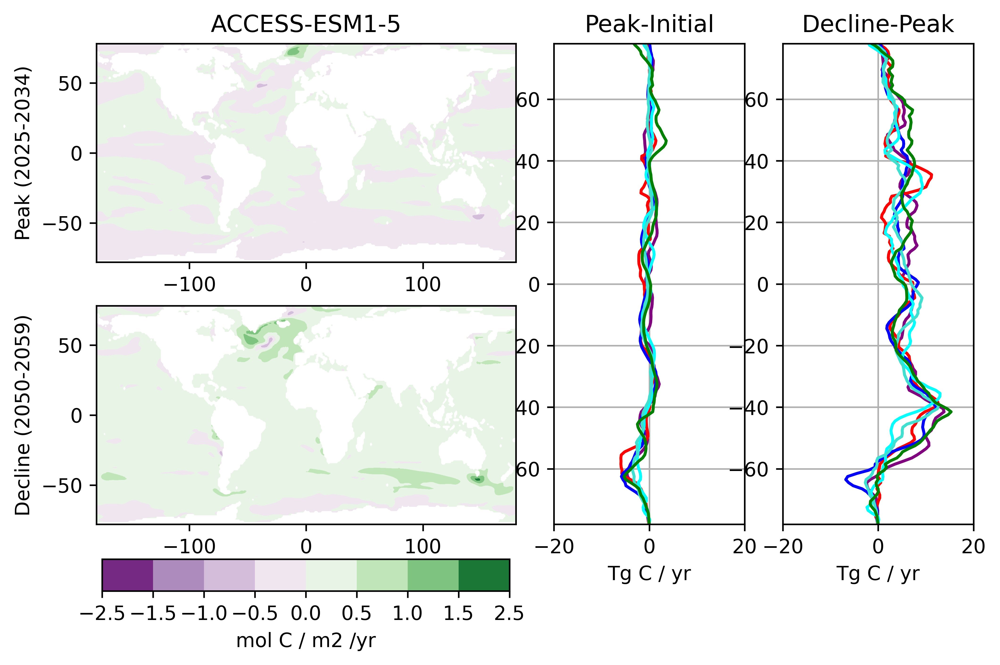

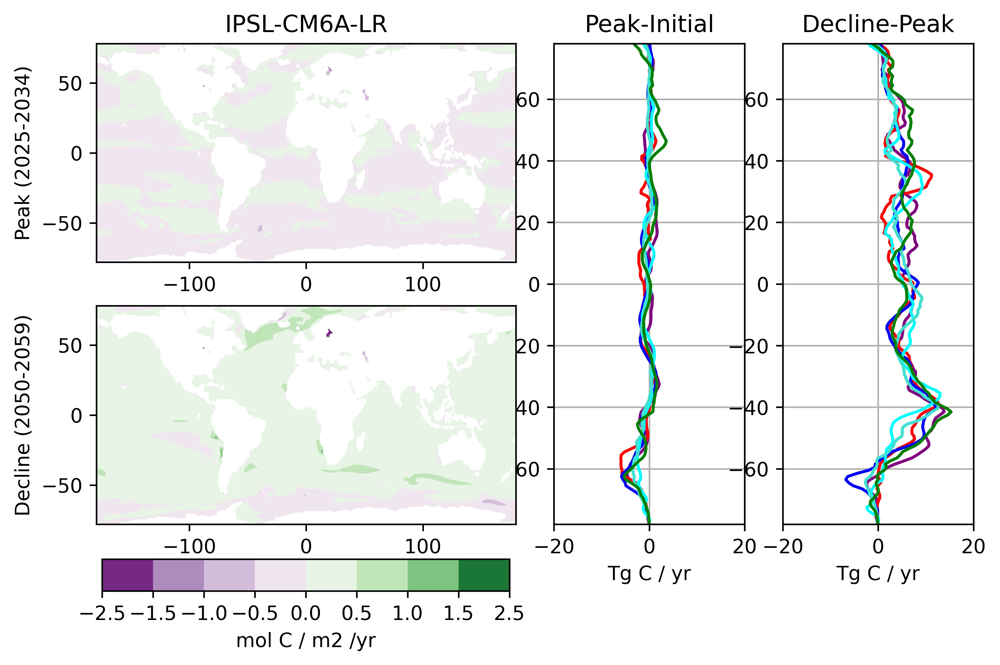

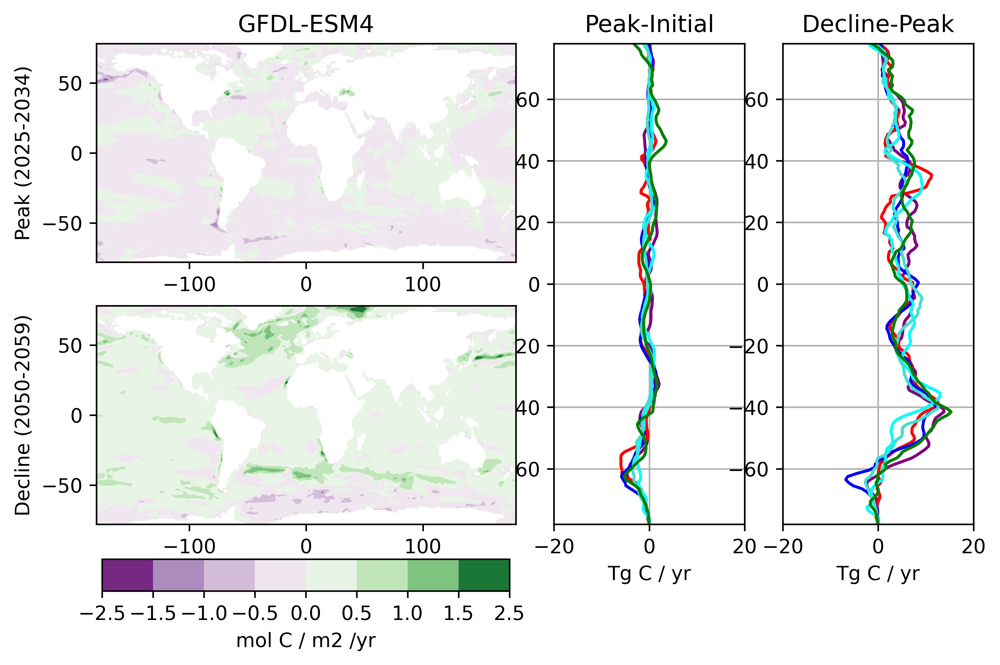

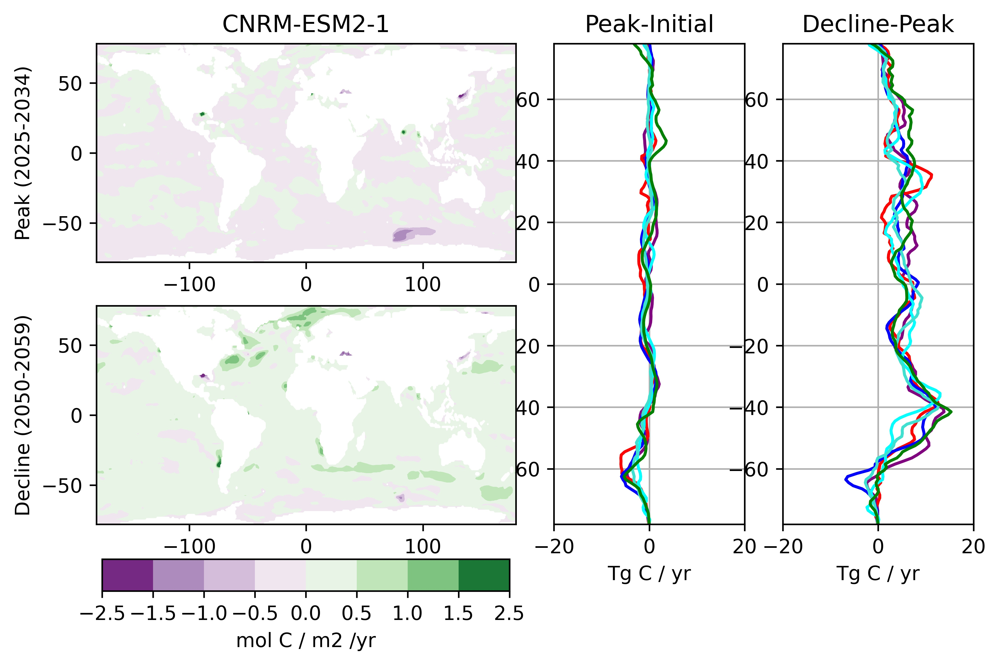

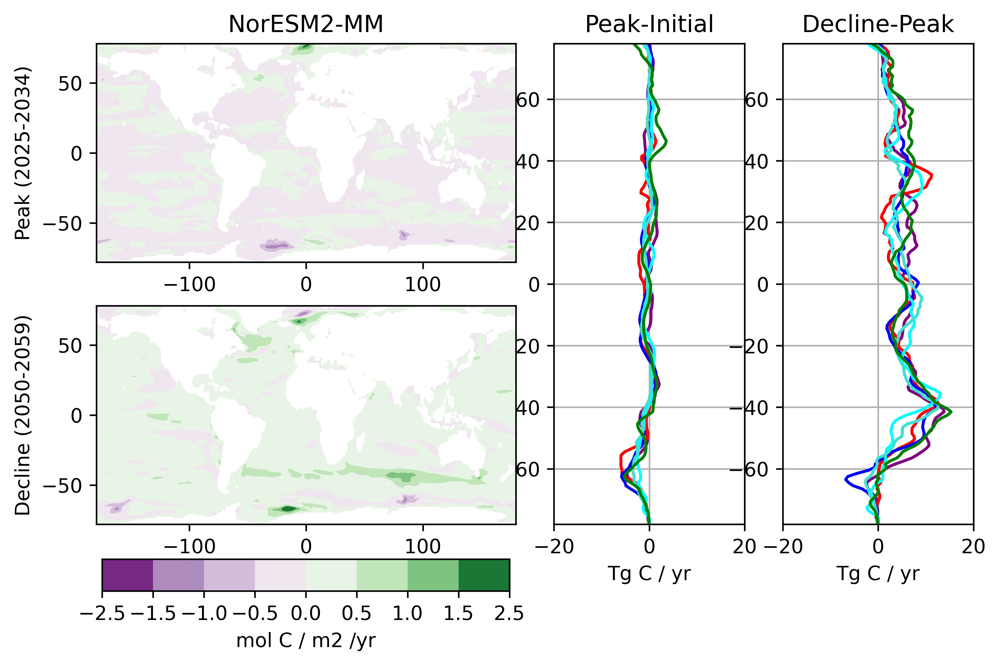

...

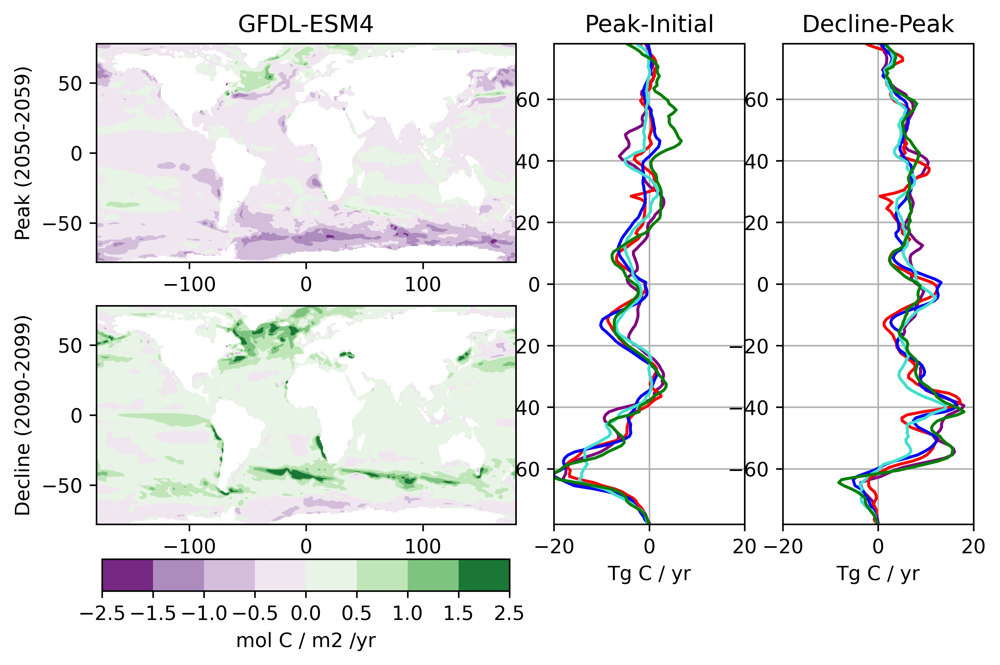

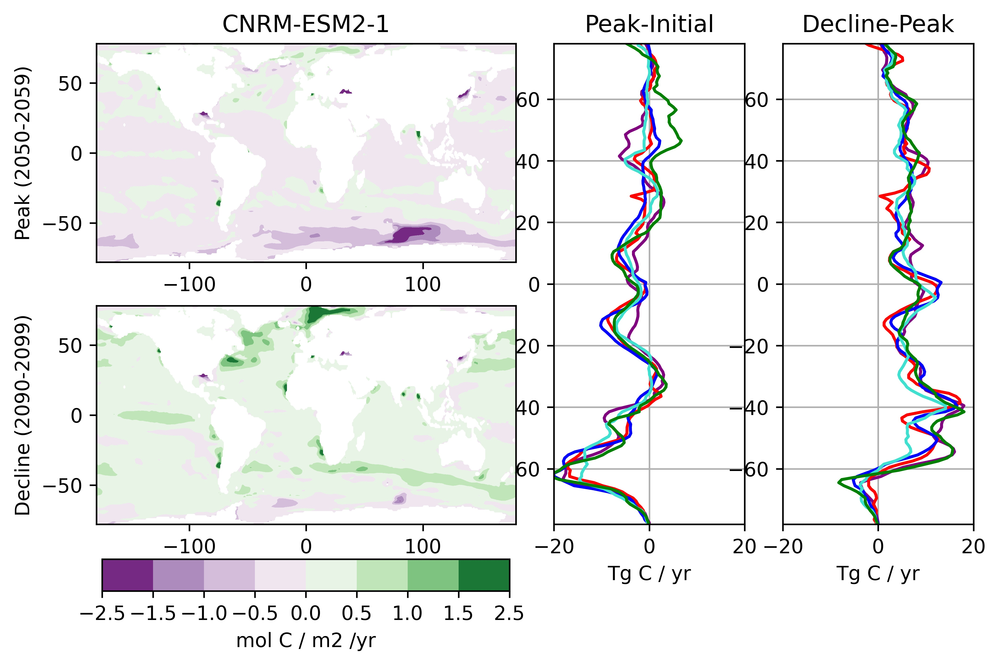

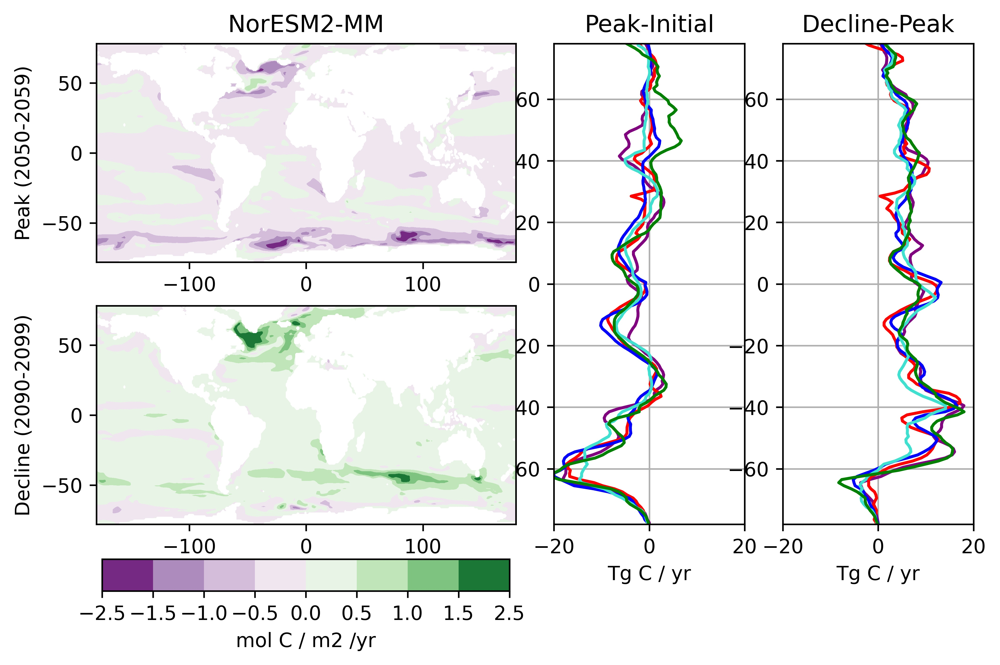

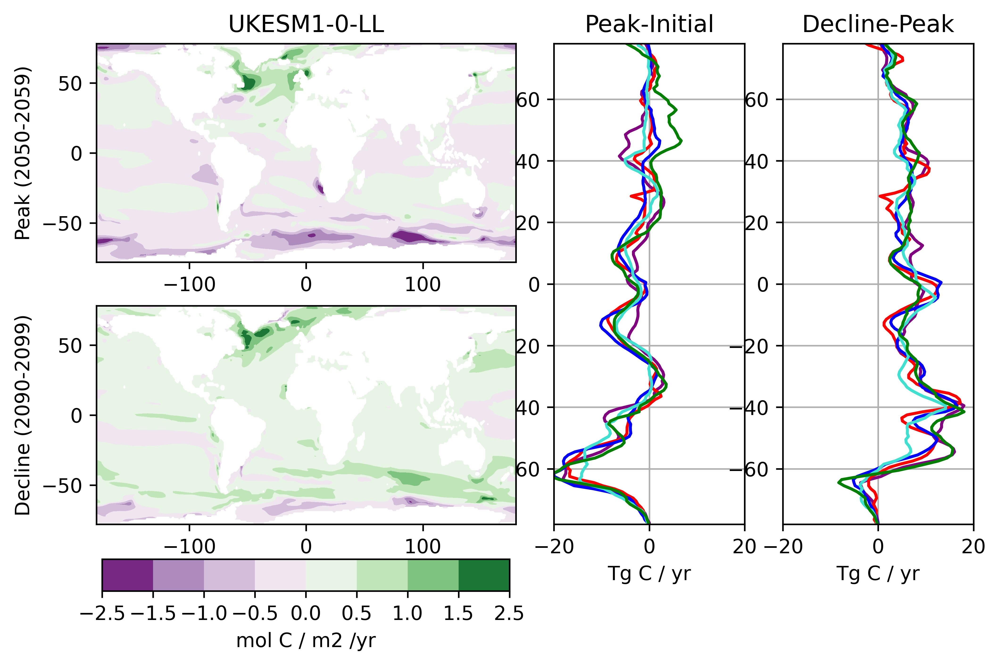

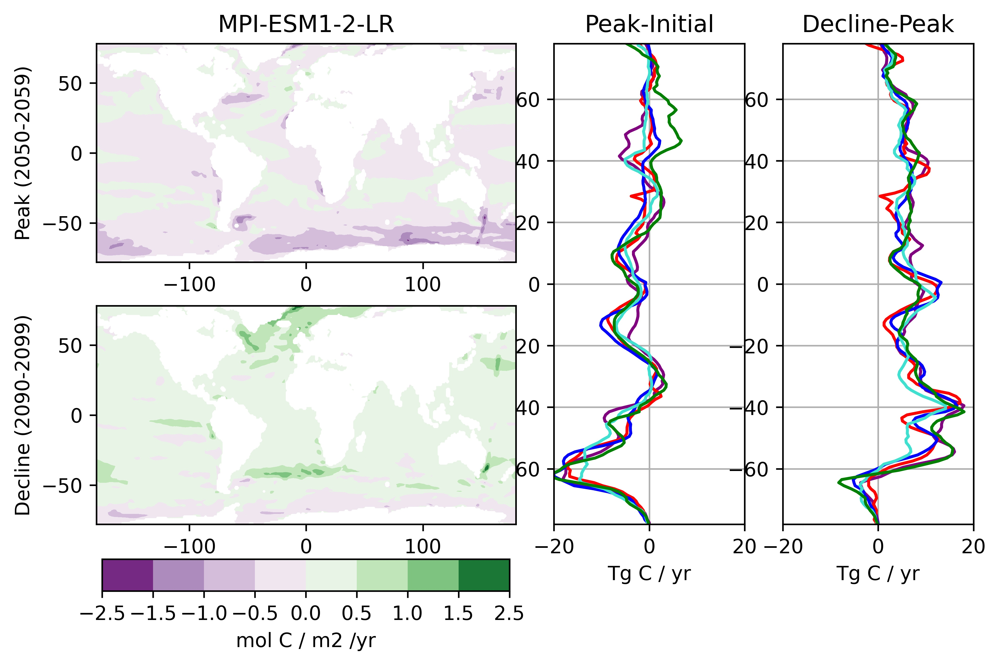

In [29]:
# SSP 1-26 and 2-45
# Create maps on left and zonal integrated flux changes on right

s = [0,2]  # Scenario 2 is SSP2-45
levs = [-2.5,-1.5,-1,-0.5,0,0.5,1,1.5,2.5]

sp1 = [2025,2050]
sp2 = [2034,2059]
sd1 = [2050,2090]
sd2 = [2059,2099]

sy=0
for scen in ["ssp126","ssp245"]:
    for mod in ["ACCESS-ESM1-5","IPSL-CM6A-LR","GFDL-ESM4","CNRM-ESM2-1","NorESM2-MM","UKESM1-0-LL","MPI-ESM1-2-LR"]:
        
        
        fig, axs = plt.subplots(ncols=4, nrows=2,figsize=(8,4.5))

        gs = axs[1, 1].get_gridspec()
        # remove the underlying axes
        for ax in axs[0:3, -2]:
            ax.remove()
        for ax in axs[0:3, -1]:
            ax.remove()    
        for ax in axs[0:3, 0]:
            ax.remove()
        for ax in axs[0:3, 1]:
            ax.remove()
        axbig1 = fig.add_subplot(gs[0:3, -2])
        axbig2 = fig.add_subplot(gs[0:3, -1])
        axmap1 = fig.add_subplot(gs[0:1, 0:2])
        axmap2 = fig.add_subplot(gs[1:2, 0:2])

        # Spatial Plots:

        ds = xr.load_dataset(f"{root_dir}/{scen_fold[s[sy]]}/processed/fgco2_Omon_{mod}_{scen}_mean_1x1_201501-210012.nc")
        ds = ds.rename({"T":"time"})
        fx = ds.fgco2.groupby("time.year").mean("time") 
        
        data1 = (-1*fx.sel(year=slice(sp1[sy],sp2[sy])).mean("year")+fx.sel(year=slice(2015,2025)).mean("year"))*1000/12*365*24*60*60
        data1 = np.where(data1>np.max(levs),np.max(levs),data1)
        data1 = np.where(data1<np.min(levs),np.min(levs),data1)
        
        x1=axmap1.contourf(lon,lat,data1,levels=levs,cmap='PRGn') # kg C / m2 / sec --> mol / m2 / yr
        axmap1.set_title(f"{mod}")
        axmap1.set_ylim(-78,78)
        axmap1.set_ylabel(f"Peak ({str(sp1[sy])}-{str(sp2[sy])})") #2050-2060
        #axmap1.set_ylimit(-78,78)
        
        data2 = (-1*fx.sel(year=slice(sd1[sy],sd2[sy])).mean("year")+fx.sel(year=slice(sp1[sy],sp2[sy])).mean("year"))*1000/12*365*24*60*60
        data2 = np.where(data2>np.max(levs),np.max(levs),data2)
        data2 = np.where(data2<np.min(levs),np.min(levs),data2)
       
        axmap2.contourf(lon,lat,data2,levels=levs,cmap='PRGn') # kg C / m2 / sec --> mol / m2 / yr
        axmap2.set_ylabel(f"Decline ({str(sd1[sy])}-{str(sd2[sy])})") # 2090-2099
        axmap2.set_ylim(-78,78)

        colors = mcolors[s[sy]]
        m = 0 # Initialize model loop
        # Loop on models
        for md in models[s[sy]]:
            
            # Difference between initial and peak flux means:
            ds=xr.open_dataset(f"{root_dir}/{scen_fold[s[sy]]}/processed/{md}_{scen}_zonalint_201501-210012.nc")
            fx = ds.zonal_flux
            data = ((-fx.sel(year=slice(sp1[sy],sp2[sy])).mean("year")+fx.sel(year=slice(2015,2025)).mean("year"))*1000) 
            axbig1.plot(data,lat,color=colors[m]) # 
            axbig1.set_title(f"Peak-Initial")
            axbig1.set_ylim(-78,78)
            axbig1.set_xlim(-20,20)
            axbig1.set_xlabel("Tg C / yr")
            axbig1.grid(True)
            
            # Difference between peak and decline flux means:
            data = ((-fx.sel(year=slice(sd1[sy],sd2[sy])).mean("year")+fx.sel(year=slice(sp1[sy],sp1[sy])).mean("year"))*1000)
            axbig2.plot(data,lat,color=colors[m]) # kg C / m2 / sec --> mol / m2 / yr
            axbig2.set_title(f"Decline-Peak")
            axbig2.set_ylim(-78,78)
            axbig2.set_xlim(-20,20)
            axbig2.set_xlabel("Tg C / yr")
            axbig2.grid(True)
            
            del ds,fx,data    
        
        
            m +=1  
    
         #Colorbar    
        position=fig.add_axes([0.13,0.02,0.36,0.05])  ## the parameters are the specified position you set 
        cbar=fig.colorbar(x1, cax=position,orientation='horizontal')
        cbar.set_label('mol C / m2 /yr')
        
        fig.savefig(f"/data/artemis/workspace/vbennington/CMIP6_figs/{scen}_{mod}_spatial_zonalintegrated.eps")
        plt.show()
    sy+=1

## Load Data Products and get Mean for comparison

In [21]:
fgco2 = xr.open_dataset('/data/artemis/observations/SOCOM/extra_files/SeaFlux_v2021.04_fgco2_all_winds_products.nc')

product_mean = fgco2.mean("wind").mean("product").sel(time=slice("01-01-2015","12-31-2019")).mean("time")

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in less
  from ipykernel import kernelapp as app
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:43: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:43: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:43: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:43: RuntimeWarning: invalid value encountered in less
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:43: RuntimeWarning: invalid value encountered in less


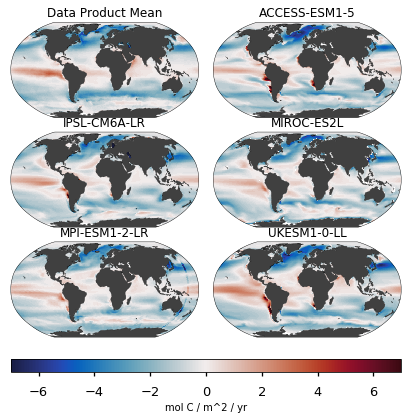

In [23]:
# SSP 1-26 and 2-45

s = [0,2]  # Scenario 2 is SSP2-45
levs = np.linspace(-7,7,15)

fig = plt.figure(figsize=(7,9))
fig_shape=(3,2)
with plt.style.context(plot_style):
    dia = SpatialMap2(nrows_ncols=fig_shape, fig=fig, cbar_location='bottom', cbar_orientation='horizontal') 

    
# Plot Data Product Mean for 2015-2020
data1 = product_mean.fgco2
data1 = np.where(data1>np.max(levs),np.max(levs),data1)
data1 = np.where(data1<np.min(levs),np.min(levs),data1)    
    
region='world'

cmap = cm.cm.balance
plot_style = 'seaborn-talk'
        
vrange = [-7, 7, 15]
          
data2 = data1
sub = dia.add_plot(lon=lon, lat=lat, data=data2, vrange=vrange[0:2], cmap=cmap, ax=0)
dia.set_title(f"Data Product Mean", 0, loc="center")    
    
    
# Plot the model mean for the same time period (2015-2019)    
sy=0
for scen in ["ssp126"]:  
    m = 0
    for mod in ['ACCESS-ESM1-5','IPSL-CM6A-LR','MIROC-ES2L','MPI-ESM1-2-LR','UKESM1-0-LL']:
       
        # Spatial Plots:

        ds = xr.load_dataset(f"{root_dir}/{scen_fold[s[sy]]}/processed/fgco2_Omon_{mod}_{scen}_mean_1x1_201501-210012.nc")
        ds = ds.rename({"T":"time"})
        fx = ds.fgco2.groupby("time.year").mean("time") 
        
        data1 = (-1*fx.sel(year=slice(2015,2019)).mean("year"))*1000/12*365*24*60*60
        data1 = np.where(data1>np.max(levs),np.max(levs),data1)
        data1 = np.where(data1<np.min(levs),np.min(levs),data1)
        
        region='world'

        cmap = cm.cm.balance
        plot_style = 'seaborn-talk'
        
        vrange = [-7, 7, 15]
          
        data2 = data1
        sub = dia.add_plot(lon=lon, lat=lat, data=data2, vrange=vrange[0:2], cmap=cmap, ax=m+1)
        dia.set_title(f"{mod}", m+1, loc="center")
            
        
        m+=1
        
col = dia.add_colorbar(sub)
dia.set_cbar_xlabel(col,"mol C / m^2 / yr",fontsize=10)       
fig.savefig(f"/data/artemis/workspace/vbennington/CMIP6_figs/flux_figures_data_models_spatial.eps")
plt.show()